# **Aplicação dos Dados: Agrupamento**

## **Instalação Biblioteca**

In [1]:
!pip install umap

In [2]:
!pip install umap-learn

## **Definindo Bibliotecas**

In [3]:
import numpy as np
import pandas as pd
import os
import sys
import umap.umap_ as umap

## **Definindo Rotas**

In [4]:
# Ver o diretório atual
diretorio = os.getcwd()
diretorio = os.path.abspath(r"../") # retornar um diretório

## **Pré-Processamento**

In [5]:
dataset = pd.read_csv(diretorio + "\\Dados\\Dataset_Compras_Cursos_Tratado.csv", sep = ",", encoding = "UTF-8", index_col= 0)

In [6]:
dataset

,email_participante,cargo_participante,setor_participante,departamento_participante,gender,cidade_cliente,produto,nome_tipo_produto,idade_participante,unidade_negocio,data_venda,preco_unitario,quantidade_itens_nessa_venda,id_venda,valor_total_venda,unidade_negocio_1,estado_comprador
0,a14kc2n0qxfcr9f+tyfcfivadaljztrslcc0ghvqfw4,president,technology,administrative,MALE,São Paulo,agrotech-0917,Agrotech Conference,39.0,Eventos e Conferências,2017-09-15 20:04:31+00:00,89000.0,1.0,8406.0,80100.0,Eventos e Conferências,SP
1,osk2ekzljvevahhtsrm++v/n4swcesobdzhadhyyywu,manager,financial,product,MALE,Três de Maio,Fintouch-0817,Fintech Conference,39.0,Eventos e Conferências,2017-08-01 23:13:39+00:00,99000.0,2.0,6161.0,99000.0,Eventos e Conferências,RS
2,xboub/wtdilb9ezppwz9skkjm8t5h/7vskj1cmu2b8e,owner,legal,juridic,FEMALE,Brasília,investclass-0118,Invest Class,39.0,Eventos e Conferências,2017-12-29 14:16:22+00:00,89000.0,2.0,12865.0,133642.0,Eventos e Conferências,DF
3,iigdi/wy3uh8jcivnxczpbf2mmtctuq6rd+y4a2jofm,manager,food_drink,dataScience,MALE,São Paulo,varejotech-conference-0818,VarejoTech Conference,40.0,Eventos e Conferências,2018-08-15 14:17:12+00:00,99000.0,1.0,29879.0,0.0,Eventos e Conferências,SP
4,nqicdmjkjj/bo7w5htn1kyjbkshppiehsqyu7jb31qy,analyst,others,humanResources,FEMALE,São Paulo,sv-conference-0918,Silicon Valley Conference,27.0,Eventos e Conferências,2018-07-05 17:36:36+00:00,239400.0,6.0,27066.0,224677.0,Eventos e Conferências,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102705,ljjybt5qhxuflmae9yltgh64xhebh8qlcgviodk+a5a,owner,others,management,MALE,Rio Claro,startseprime,StartSe Prime,49.0,Programas Online,2020-06-03 16:21:55+00:00,17880.0,1.0,84961.0,17880.0,Programas Online,SP
102706,xpm7du3rh96b9fj+qmbtqbxzd5of59abrfquhok1vh4,president,pro_services,management,MALE,Santos,sociedade-e-cultura-for-business-ed9a21,Partnership & Cultura,39.0,Programas Online,2021-09-02 21:38:44+00:00,450000.0,1.0,101701.0,382500.0,Programas Online,SP
102707,6kdidjxf9yyx/pxjsivgczrbr+ubp90pbbyhs1tbjt8,director,technology,seller,MALE,São Bernardo do Campo,xba-ed14a21,XBA,41.0,Programas Online,2021-09-30 09:43:23+00:00,990000.0,1.0,102703.0,693000.0,Programas Online,SP
102708,6kdidjxf9yyx/pxjsivgczrbr+ubp90pbbyhs1tbjt8,director,technology,seller,MALE,São Bernardo do Campo,cmo-program-ed1a22,CMO Xponential Program,42.0,Programas Online,2022-02-06 00:40:54+00:00,850000.0,1.0,106885.0,595000.0,Programas Online,SP


In [7]:
dataset.dtypes

email_participante               object
cargo_participante               object
setor_participante               object
departamento_participante        object
gender                           object
cidade_cliente                   object
produto                          object
nome_tipo_produto                object
idade_participante              float64
unidade_negocio                  object
data_venda                       object
preco_unitario                  float64
quantidade_itens_nessa_venda    float64
id_venda                        float64
valor_total_venda               float64
unidade_negocio_1                object
estado_comprador                 object
dtype: object

### **Codificação das Variáveis Categóricas**

In [8]:
from sklearn.preprocessing import LabelEncoder

In [9]:
dataset.head()

,email_participante,cargo_participante,setor_participante,departamento_participante,gender,cidade_cliente,produto,nome_tipo_produto,idade_participante,unidade_negocio,data_venda,preco_unitario,quantidade_itens_nessa_venda,id_venda,valor_total_venda,unidade_negocio_1,estado_comprador
0,a14kc2n0qxfcr9f+tyfcfivadaljztrslcc0ghvqfw4,president,technology,administrative,MALE,São Paulo,agrotech-0917,Agrotech Conference,39.0,Eventos e Conferências,2017-09-15 20:04:31+00:00,89000.0,1.0,8406.0,80100.0,Eventos e Conferências,SP
1,osk2ekzljvevahhtsrm++v/n4swcesobdzhadhyyywu,manager,financial,product,MALE,Três de Maio,Fintouch-0817,Fintech Conference,39.0,Eventos e Conferências,2017-08-01 23:13:39+00:00,99000.0,2.0,6161.0,99000.0,Eventos e Conferências,RS
2,xboub/wtdilb9ezppwz9skkjm8t5h/7vskj1cmu2b8e,owner,legal,juridic,FEMALE,Brasília,investclass-0118,Invest Class,39.0,Eventos e Conferências,2017-12-29 14:16:22+00:00,89000.0,2.0,12865.0,133642.0,Eventos e Conferências,DF
3,iigdi/wy3uh8jcivnxczpbf2mmtctuq6rd+y4a2jofm,manager,food_drink,dataScience,MALE,São Paulo,varejotech-conference-0818,VarejoTech Conference,40.0,Eventos e Conferências,2018-08-15 14:17:12+00:00,99000.0,1.0,29879.0,0.0,Eventos e Conferências,SP
4,nqicdmjkjj/bo7w5htn1kyjbkshppiehsqyu7jb31qy,analyst,others,humanResources,FEMALE,São Paulo,sv-conference-0918,Silicon Valley Conference,27.0,Eventos e Conferências,2018-07-05 17:36:36+00:00,239400.0,6.0,27066.0,224677.0,Eventos e Conferências,SP


In [10]:
columns_cat = list(dataset.select_dtypes(include=['object']).columns)
columns_cat

['email_participante',
 'cargo_participante',
 'setor_participante',
 'departamento_participante',
 'gender',
 'cidade_cliente',
 'produto',
 'nome_tipo_produto',
 'unidade_negocio',
 'data_venda',
 'unidade_negocio_1',
 'estado_comprador']

In [11]:
le = LabelEncoder()

In [12]:
dataset[columns_cat] = dataset[columns_cat].apply(le.fit_transform)

In [13]:
dataset

,email_participante,cargo_participante,setor_participante,departamento_participante,gender,cidade_cliente,produto,nome_tipo_produto,idade_participante,unidade_negocio,data_venda,preco_unitario,quantidade_itens_nessa_venda,id_venda,valor_total_venda,unidade_negocio_1,estado_comprador
0,14955,12,35,2,1,892,33,6,39.0,2,3545,89000.0,1.0,8406.0,80100.0,2,38
1,52376,9,16,25,1,946,2,49,39.0,2,2377,99000.0,2.0,6161.0,99000.0,2,32
2,73710,11,22,15,0,129,328,78,39.0,2,5578,89000.0,2.0,12865.0,133642.0,2,6
3,36205,9,17,8,1,892,748,165,40.0,2,15435,99000.0,1.0,29879.0,0.0,2,38
4,49696,0,29,13,0,892,725,147,27.0,2,13585,239400.0,6.0,27066.0,224677.0,2,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102705,44057,11,29,17,1,733,713,152,49.0,7,44856,17880.0,1.0,84961.0,17880.0,7,38
102706,74816,12,31,17,1,806,707,129,39.0,7,52204,450000.0,1.0,101701.0,382500.0,7,38
102707,10473,4,35,28,1,845,782,171,41.0,7,52653,990000.0,1.0,102703.0,693000.0,7,38
102708,10473,4,35,28,1,845,67,15,42.0,7,54789,850000.0,1.0,106885.0,595000.0,7,38


### **Excluir identificação de venda e data**

In [14]:
dataset_2 = dataset.loc[:, ~dataset.columns.isin(['id_venda', 'data_venda'])]



In [15]:
dataset_2

,email_participante,cargo_participante,setor_participante,departamento_participante,gender,cidade_cliente,produto,nome_tipo_produto,idade_participante,unidade_negocio,preco_unitario,quantidade_itens_nessa_venda,valor_total_venda,unidade_negocio_1,estado_comprador
0,14955,12,35,2,1,892,33,6,39.0,2,89000.0,1.0,80100.0,2,38
1,52376,9,16,25,1,946,2,49,39.0,2,99000.0,2.0,99000.0,2,32
2,73710,11,22,15,0,129,328,78,39.0,2,89000.0,2.0,133642.0,2,6
3,36205,9,17,8,1,892,748,165,40.0,2,99000.0,1.0,0.0,2,38
4,49696,0,29,13,0,892,725,147,27.0,2,239400.0,6.0,224677.0,2,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102705,44057,11,29,17,1,733,713,152,49.0,7,17880.0,1.0,17880.0,7,38
102706,74816,12,31,17,1,806,707,129,39.0,7,450000.0,1.0,382500.0,7,38
102707,10473,4,35,28,1,845,782,171,41.0,7,990000.0,1.0,693000.0,7,38
102708,10473,4,35,28,1,845,67,15,42.0,7,850000.0,1.0,595000.0,7,38


### **Escalonamento Variáveis Numéricas**

In [16]:
dataset_2.dtypes

email_participante                int32
cargo_participante                int32
setor_participante                int32
departamento_participante         int32
gender                            int32
cidade_cliente                    int32
produto                           int32
nome_tipo_produto                 int32
idade_participante              float64
unidade_negocio                   int32
preco_unitario                  float64
quantidade_itens_nessa_venda    float64
valor_total_venda               float64
unidade_negocio_1                 int32
estado_comprador                  int32
dtype: object

In [17]:
columns_num = list(dataset_2.select_dtypes(include=['float64']).columns)
columns_num

['idade_participante',
 'preco_unitario',
 'quantidade_itens_nessa_venda',
 'valor_total_venda']

In [18]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()


In [19]:
dataset_2[['preco_unitario', 'valor_total_venda']] = scaler.fit_transform(dataset_2[['preco_unitario', 'valor_total_venda']])

C:\Users\40026\AppData\Local\Temp\ipykernel_15968\2428896924.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset_2[['preco_unitario', 'valor_total_venda']] = scaler.fit_transform(dataset_2[['preco_unitario', 'valor_total_venda']])


In [20]:
dataset_2

,email_participante,cargo_participante,setor_participante,departamento_participante,gender,cidade_cliente,produto,nome_tipo_produto,idade_participante,unidade_negocio,preco_unitario,quantidade_itens_nessa_venda,valor_total_venda,unidade_negocio_1,estado_comprador
0,14955,12,35,2,1,892,33,6,39.0,2,-0.215047,1.0,-0.209223,2,38
1,52376,9,16,25,1,946,2,49,39.0,2,-0.209625,2.0,-0.198555,2,32
2,73710,11,22,15,0,129,328,78,39.0,2,-0.215047,2.0,-0.179003,2,6
3,36205,9,17,8,1,892,748,165,40.0,2,-0.209625,1.0,-0.254432,2,38
4,49696,0,29,13,0,892,725,147,27.0,2,-0.133494,6.0,-0.127621,2,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102705,44057,11,29,17,1,733,713,152,49.0,7,-0.253612,1.0,-0.244340,7,38
102706,74816,12,31,17,1,806,707,129,39.0,7,-0.019298,1.0,-0.038544,7,38
102707,10473,4,35,28,1,845,782,171,41.0,7,0.273513,1.0,0.136707,7,38
102708,10473,4,35,28,1,845,67,15,42.0,7,0.197599,1.0,0.081394,7,38


## **Aprendizagem por Agrupamento**

### **Transformação em Matriz**

In [21]:
dados_agru = np.array(dataset_2)

In [22]:
dados_agru

array([[12.        , 35.        ,  2.        , ..., -0.20922254,
         2.        , 38.        ],
       [ 9.        , 16.        , 25.        , ..., -0.19855512,
         2.        , 32.        ],
       [11.        , 22.        , 15.        , ..., -0.17900268,
         2.        ,  6.        ],
       ...,
       [ 4.        , 35.        , 28.        , ...,  0.13670684,
         7.        , 38.        ],
       [ 4.        , 35.        , 28.        , ...,  0.08139427,
         7.        , 38.        ],
       [ 9.        , 35.        , 17.        , ..., -0.21830961,
         7.        , 36.        ]])

### **K-Means**

#### **Elbow Method**

In [23]:
from sklearn.cluster import KMeans
wcss = []
for i in range(1,15):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 5, max_iter = 300)
    kmeans.fit(dados_agru)
# Método inertia para gerar o wcss
    wcss.append(kmeans.inertia_)

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns

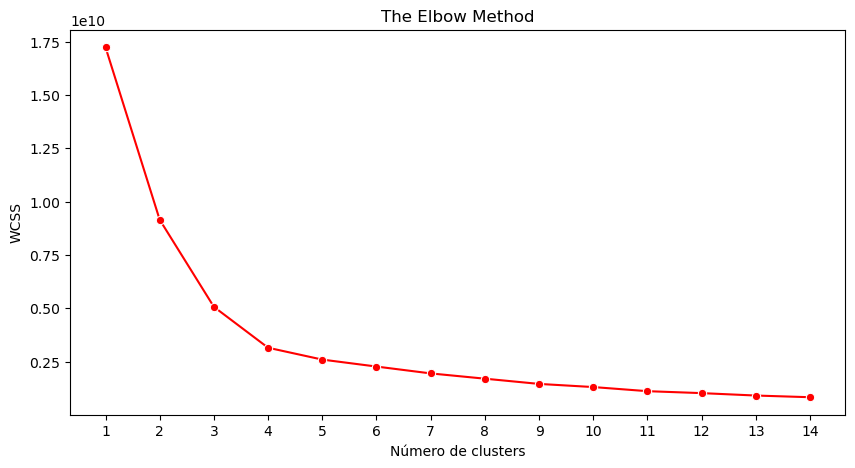

In [25]:
plt.figure(figsize=(10,5))
sns.lineplot( x = range(1, 15), y = wcss,marker='o',color='red')
plt.title('The Elbow Method')
plt.xlabel('Número de clusters')
plt.ylabel('WCSS');
plt.xticks(range(1,15));

#### **Agrupamento**

In [24]:
kmeans = KMeans(n_clusters = 4, init = 'k-means++', random_state = 5, max_iter = 300)


In [25]:
kmeans_ori = kmeans.fit(dados_agru)

In [66]:
# Coordenadas dos Centróides
centroides = kmeans_ori.cluster_centers_
centroides

array([[ 7.87375687e+00,  2.28273712e+01,  1.67053585e+01,
         6.94052744e-01,  8.29585547e+02,  1.98648558e+02,
         5.09498046e+01,  3.90922765e+01,  2.69370640e+00,
        -1.00314826e-01,  4.85413884e+00, -9.61183258e-02,
         2.69370640e+00,  3.33700955e+01],
       [ 6.20955491e+00,  2.17342230e+01,  1.63873074e+01,
         6.69553489e-01,  2.27363527e+02,  6.85344644e+02,
         1.47917939e+02,  3.87616242e+01,  4.20905800e+00,
         2.06207621e-01,  4.33970327e+01,  2.05284331e-01,
         4.20905800e+00,  2.52668418e+01],
       [ 6.13197879e+00,  2.20717717e+01,  1.68433619e+01,
         6.33064086e-01,  8.30109739e+02,  6.77002277e+02,
         1.47520905e+02,  3.88285236e+01,  3.60267587e+00,
         8.63190306e-02,  1.86415329e+01,  7.61301301e-02,
         3.60267587e+00,  3.34590969e+01],
       [ 7.99786048e+00,  2.33147577e+01,  1.67068863e+01,
         7.30122400e-01,  2.39440691e+02,  1.99412927e+02,
         5.02831127e+01,  3.88795900e+01,  2.

In [26]:
# Classificação dos dados
classif = kmeans.labels_
classif

array([0, 0, 3, ..., 2, 0, 3])

In [30]:
np.unique(classif, return_counts = True)

(array([0, 1, 2, 3]), array([40423, 14087, 28102, 20098], dtype=int64))

#### **Visualização Gráfica**

**UMAP:Reduzir dimensionalidade para duas visualizar no gráfico**

In [22]:
reducer_2 = umap.UMAP(n_components=2)
dados_agru_two_dim  = reducer_2.fit_transform(dados_agru)

In [32]:
dados_agru_two_dim

array([[-13.447641 ,  -3.4227862],
       [-11.8261595,   5.925922 ],
       [  7.3302712,   2.1763563],
       ...,
       [ 14.132317 ,   4.9156327],
       [ -1.8400936,  14.773724 ],
       [  3.0154884,   8.54665  ]], dtype=float32)

In [33]:
kmeans2 = KMeans(n_clusters = 4, init = 'k-means++', random_state = 5, max_iter = 300)


In [34]:
kmeans2 = kmeans2.fit(dados_agru_two_dim)

In [35]:
# Coordenadas dos Centróides
centroides2 = kmeans2.cluster_centers_
centroides2

array([[-0.12816775, -3.842579  ],
       [ 1.5263567 , 12.608383  ],
       [ 9.878084  ,  3.5566697 ],
       [-8.072069  ,  5.1280036 ]], dtype=float32)

In [36]:
# Classificação dos dados
classif_2 = kmeans2.labels_
classif_2

array([3, 3, 2, ..., 2, 1, 1])

In [37]:
# Retorna a quantidade de grupos identificados
np.unique(classif_2, return_counts = True)

(array([0, 1, 2, 3]), array([26661, 26917, 24559, 24573], dtype=int64))

In [38]:
import plotly.express as px
import plotly.graph_objects as go

In [39]:
graf1 = px.scatter(x = dados_agru_two_dim[:,0], y = dados_agru_two_dim[:,1], color=classif_2)
graf2 = px.scatter(x = centroides2[:,0], y = centroides2[:,1], size = [15, 15, 15, 15])
graf3 = go.Figure(data = graf1.data + graf2.data)
graf3.update_layout(width=800,height=500,title_text='Agrupamento K-Means')
graf3.update_xaxes(title = 'Componente 1')
graf3.update_yaxes(title = 'Componente 2')
graf3.show()

### **Agrupamento Hierárquico**

#### **Amostragem Estratificada**

In [21]:
dataset_2.dtypes

cargo_participante                int32
setor_participante                int32
departamento_participante         int32
gender                            int32
cidade_cliente                    int32
produto                           int32
nome_tipo_produto                 int32
idade_participante              float64
unidade_negocio                   int32
preco_unitario                  float64
quantidade_itens_nessa_venda    float64
valor_total_venda               float64
unidade_negocio_1                 int32
estado_comprador                  int32
dtype: object

In [22]:
dataset_2.groupby('setor_participante').size()

setor_participante
0         2
1        15
2        11
3         8
4        43
5         9
6         2
7         3
8         2
9      2813
10      960
11     5078
12     8086
13    10298
14      917
15      299
16    12099
17     2695
18      225
19     5675
20      305
21      657
22     5226
23     3242
24     1274
25      923
26      669
27      403
28      182
29    10944
30      101
31     4380
32      653
33      190
34     4838
35    18533
36      950
dtype: int64

**36 a quantidade de setores diferentes dos clientes**

In [24]:
from sklearn.model_selection import train_test_split

In [25]:
x = dataset_2.drop('setor_participante', axis=1)
y = dataset_2['setor_participante']

In [26]:
# Realizar a divisão estratificada dos clientes por setores
x_treino, x_teste, y_treino, amos_estra_set = train_test_split(x, y, 
                                                           stratify= y)

In [27]:
# verificar se a soma será igual a 1
print(amos_estra_set.value_counts(normalize=True).sum())


1.0


In [27]:
amos_estra_set.value_counts()

35    4633
16    3025
29    2736
13    2575
12    2022
19    1419
22    1307
11    1270
34    1210
31    1095
23     811
9      703
17     674
24     319
10     240
36     237
25     231
14     229
26     167
21     164
32     163
27     101
20      76
15      75
18      56
33      47
28      45
30      25
4       11
1        4
2        3
3        2
5        2
7        1
Name: setor_participante, dtype: int64

In [28]:
# Criar um índice
amos_estra_set = amos_estra_set.index

In [29]:
# Filtrar dentro da base
dataset_estra_set = dataset_2.loc[amos_estra_set, :]

In [30]:
dataset_estra_set

,email_participante,cargo_participante,setor_participante,departamento_participante,gender,cidade_cliente,produto,nome_tipo_produto,idade_participante,unidade_negocio,preco_unitario,quantidade_itens_nessa_venda,valor_total_venda,unidade_negocio_1,estado_comprador
54598,59711,12,12,12,1,704,636,151,32.0,4,-0.236249,1.0,-0.240322,4,14
1324,66213,4,13,28,1,892,640,147,28.0,2,-0.230827,1.0,-0.254432,2,38
64881,9342,0,29,13,1,892,645,148,31.0,2,1.288048,60.0,1.360357,2,38
26631,4800,12,35,2,1,806,33,6,39.0,2,-0.215047,1.0,-0.224292,2,38
82694,12454,9,16,25,1,892,137,43,39.0,2,-0.192816,3.0,-0.130483,2,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7547,27503,12,14,22,0,129,63,131,49.0,2,-0.209625,2.0,-0.191503,2,6
30377,71396,12,13,17,1,892,19,5,32.0,2,-0.214559,1.0,-0.227578,2,38
31933,50600,9,23,21,1,260,726,147,38.0,2,-0.209625,2.0,-0.198555,2,17
78483,72022,11,33,22,0,892,155,45,32.0,6,0.436185,1.0,-0.254432,6,38


#### **Transformar em matriz**

In [31]:
dados_agru_2 = np.array(dataset_estra_set)

In [51]:
dados_agru_2

array([[ 1.20000000e+01,  1.20000000e+01,  1.20000000e+01, ...,
        -2.09448307e-01,  2.00000000e+00,  3.80000000e+01],
       [ 1.20000000e+01,  3.50000000e+01,  2.00000000e+00, ...,
        -1.74059544e-01,  2.00000000e+00,  3.20000000e+01],
       [ 1.20000000e+01,  2.90000000e+01,  3.10000000e+01, ...,
         2.60811217e-02,  7.00000000e+00,  2.70000000e+01],
       ...,
       [ 3.00000000e+00,  2.90000000e+01,  2.00000000e+00, ...,
        -2.20905913e-01,  2.00000000e+00,  4.00000000e+00],
       [ 1.20000000e+01,  1.20000000e+01,  1.20000000e+01, ...,
        -7.08902959e-02,  2.00000000e+00,  1.00000000e+01],
       [ 9.00000000e+00,  3.50000000e+01,  1.70000000e+01, ...,
        -1.53853521e-01,  2.00000000e+00,  3.80000000e+01]])

#### **Dendograma**

In [52]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

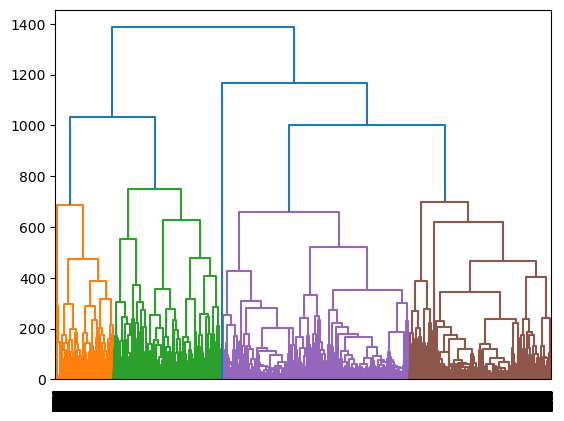

In [53]:
dendrograma = dendrogram(linkage(dados_agru_2, method = 'complete'))

In [70]:
from sklearn.cluster import AgglomerativeClustering

In [55]:
hier = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage = 'complete')
classif_hie = hier.fit_predict(dados_agru_2)

In [56]:
np.unique(classif_hie, return_counts = True)

(array([0, 1, 2, 3], dtype=int64),
 array([17045,  5599,     4,  3030], dtype=int64))

#### **Visualização Gráfica**

**UMAP:Reduzir dimensionalidade para duas visualizar no gráfico**

In [32]:
reducer_2 = umap.UMAP(n_components=2)
dados_agru_two_dim_hie  = reducer_2.fit_transform(dados_agru_2)

In [58]:
dados_agru_two_dim_hie

array([[  3.732526  ,   7.1611304 ],
       [  0.96665555,  -3.7911534 ],
       [  6.0789557 ,  -5.5481377 ],
       ...,
       [ -9.588997  ,  -3.2789247 ],
       [ -0.01816483,   0.39676797],
       [-10.973964  ,   5.6554775 ]], dtype=float32)

In [59]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

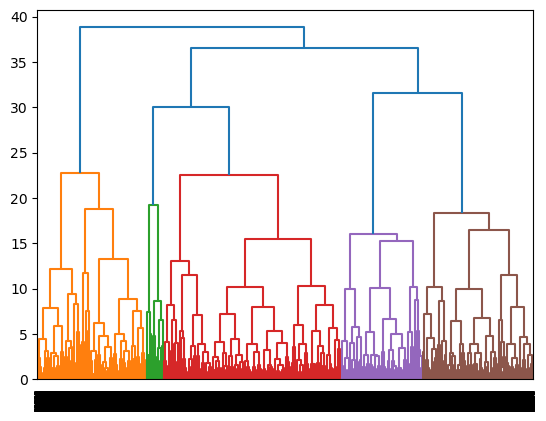

In [60]:
dendrograma = dendrogram(linkage(dados_agru_two_dim_hie, method = 'complete'))

In [61]:
from sklearn.cluster import AgglomerativeClustering

In [62]:
hier = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage = 'complete')
classif_hie = hier.fit_predict(dados_agru_two_dim_hie)

In [63]:
np.unique(classif_hie, return_counts = True)

(array([0, 1, 2, 3], dtype=int64),
 array([10093,  5653,  5712,  4220], dtype=int64))

In [64]:
import plotly.express as px

In [65]:
graf1 = px.scatter(x = dados_agru_two_dim_hie[:,0], y = dados_agru_two_dim_hie[:,1], color=classif_hie)
graf2 = px.scatter(x = centroides2[:,0], y = centroides2[:,1], size = [15, 15, 15, 15])
graf3 = go.Figure(data = graf1.data + graf2.data)
graf3.update_layout(width=800,height=500,title_text='Agrupamento Hieráquico')
graf3.update_xaxes(title = 'Componente 1')
graf3.update_yaxes(title = 'Componente 2')
graf3.show()

### **DBSCAN**

In [44]:
from sklearn.cluster import DBSCAN

In [55]:
reducer_3 = umap.UMAP(n_components=2)
dados_agru_two_dim  = reducer_3.fit_transform(dados_agru_2)

c:\Users\40026\Anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


#### **Determinar Valores dos Parâmetros**

##### **Curva do Nearest Neighbors**

In [99]:
from sklearn.neighbors import NearestNeighbors
import plotly.graph_objects as go


In [100]:
k_dist_values = []
k_values = range(2, 10)  # Escolha um intervalo adequado para K
k_dist_values = []
for k in k_values:
    nbrs = NearestNeighbors(n_neighbors=k)
    distances, _ = nbrs.fit(dados_agru_two_dim).kneighbors(dados_agru_two_dim)
    k_dist = np.sort(distances[:, -1])
    k_dist_values.append(k_dist)

# Criar um gráfico interativo com o Plotly
fig = go.Figure()

for k, dist in zip(k_values, k_dist_values):
    fig.add_trace(go.Scatter(x=np.arange(len(dist)), y=dist, mode='lines', name=f'k={k}'))

fig.update_layout(
    title='Curva K-Dist',
    xaxis_title='Índice do Ponto',
    yaxis_title='Distância do k-ésimo Vizinho',
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
    showlegend=True
)

fig.show()

**Valor eps perto entre o valor 40 e 50. Quando o "cotovelo" começa a crescer.**

##### **GridSearchCV com Coeficiente de Silhueta e Índice Davies-Bouldin**

In [74]:
from sklearn.metrics import silhouette_score
from sklearn.model_selection import GridSearchCV

In [78]:
import warnings

In [105]:
from sklearn.metrics import silhouette_score, davies_bouldin_score, make_scorer
from sklearn.model_selection import GridSearchCV
warnings.filterwarnings("ignore") # ignorar avisos
param_grid = {
    'min_samples': np.linspace(0.1, 5.0, 10), # Exemplo: variando de 0.1 a 5.0 com 30 valores no total
    'eps': np.linspace(0.1, 5.0, 10) # Exemplo: variando de 0.1 a 5.0 com 30 valores no total
}
# Criar o estimador do DBSCAN
dbscan = DBSCAN()

# Criar uma função de avaliação customizada para o Coeficiente de Silhueta
silhouette_scorer = make_scorer(silhouette_score, greater_is_better=True)

# Criar o objeto GridSearchCV com validação cruzada usando a função de avaliação do Coeficiente de Silhueta
grid_search_silhouette = GridSearchCV(dbscan, param_grid, scoring=silhouette_scorer)

# Realizar a busca de grid para o Coeficiente de Silhueta e treinar o modelo com a melhor combinação de hiperparâmetros
grid_search_silhouette.fit(dados_agru_two_dim)

# Melhores hiperparâmetros encontrados para o Coeficiente de Silhueta
best_min_samples_silhouette = grid_search_silhouette.best_params_['min_samples']
best_eps_silhouette = grid_search_silhouette.best_params_['eps']

print("Melhores hiperparâmetros encontrados (Coeficiente de Silhueta):")
print("min_samples:", best_min_samples_silhouette)
print("eps:", best_eps_silhouette)

# Calcular manualmente o Coeficiente de Silhueta para a melhor combinação de hiperparâmetros
best_dbscan_silhouette = DBSCAN(eps=best_eps_silhouette, min_samples=best_min_samples_silhouette)
labels_silhouette = best_dbscan_silhouette.fit_predict(dados_agru_two_dim)
silhouette_avg = silhouette_score(dados_agru_two_dim, labels_silhouette)
print("Coeficiente de Silhueta para a melhor combinação:", silhouette_avg)

# Criar uma função de avaliação customizada para o Índice Davies-Bouldin
davies_bouldin_scorer = make_scorer(davies_bouldin_score, greater_is_better=False)

# Criar o objeto GridSearchCV com validação cruzada usando a função de avaliação do Índice Davies-Bouldin
grid_search_db = GridSearchCV(dbscan, param_grid, scoring=davies_bouldin_scorer)

# Realizar a busca de grid para o Índice Davies-Bouldin e treinar o modelo com a melhor combinação de hiperparâmetros
grid_search_db.fit(dados_agru_two_dim)

# Melhores hiperparâmetros encontrados para o Índice Davies-Bouldin
best_min_samples_db = grid_search_db.best_params_['min_samples']
best_eps_db = grid_search_db.best_params_['eps']

print("Melhores hiperparâmetros encontrados (Índice Davies-Bouldin):")
print("min_samples:", best_min_samples_db)
print("eps:", best_eps_db)

# Calcular manualmente o Índice Davies-Bouldin para a melhor combinação de hiperparâmetros
best_dbscan_db = DBSCAN(eps=best_eps_db, min_samples=best_min_samples_db)
labels_db = best_dbscan_db.fit_predict(dados_agru_two_dim)
db_index = davies_bouldin_score(dados_agru_2, labels_db)
print("Índice Davies-Bouldin para a melhor combinação:", db_index)

Melhores hiperparâmetros encontrados (Coeficiente de Silhueta):
min_samples: 0.1
eps: 0.1
Coeficiente de Silhueta para a melhor combinação: 0.53535277
Melhores hiperparâmetros encontrados (Índice Davies-Bouldin):
min_samples: 0.1
eps: 0.1
Índice Davies-Bouldin para a melhor combinação: 1.0913446209244935


**- Coeficiente Silhueta:(1 a -1), quanto mais próximo do 1 indicam pontos mais bem agrupados, enquanto valores negativos indicam agrupamentos que podem não ser tão bem separados;**  
**- Índice Davies-Bouldin (0 ao infinito), valores menores indicam agrupamentos mais compactos e bem separados.**

#### **Visualização Gráfica**

In [32]:
from sklearn.cluster import DBSCAN

In [93]:
dbscan = DBSCAN(eps = 0.2, min_samples=0.05)
dbscan.fit(dados_agru_two_dim)

DBSCAN(eps=0.2, min_samples=0.05)

In [94]:
classif_4 = dbscan.labels_
classif_4

array([  0,   1,   2, ...,  87,  22, 290], dtype=int64)

In [95]:
np.unique(classif_4, return_counts = True)

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

In [90]:
import plotly.express as px

In [96]:
graf1 = px.scatter(x = dados_agru_two_dim[:,0], y = dados_agru_two_dim[:,1], color=classif_4)
graf1.update_layout(width=800,height=500,title_text='DBSCAN')
graf1.update_xaxes(title = 'Componente 1')
graf1.update_yaxes(title = 'Componente 2')
graf1.show()

### **MEANSHIFT**

In [32]:
from sklearn.cluster import MeanShift

In [31]:
reducer_4 = umap.UMAP(n_components=2)
dados_agru_two_dim  = reducer_4.fit_transform(dados_agru_2)

c:\Users\40026\Anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


#### **Determinar Valores dos Parâmetros**

##### **GridSearchCV**

In [33]:
from sklearn.model_selection import GridSearchCV

In [34]:
import warnings

In [39]:
from sklearn.model_selection import GridSearchCV
warnings.filterwarnings("ignore") # ignorar avisos
param_grid = {
    'bandwidth': [1, 2.5, 5]  # Exemplo: variando de 0.1 a 5.0 com 10 valores no total
}
# Criar o estimador do DBSCAN
meanshift = MeanShift()

# Criar o objeto GridSearchCV com validação cruzada usando o Coeficiente de Silhueta como métrica
grid_search = GridSearchCV(meanshift, param_grid, scoring='neg_mean_squared_error')

# Realizar a busca de grid para a largura de banda e treinar o modelo com o melhor valor encontrado
grid_search.fit(dados_agru_two_dim)

# Melhor valor de largura de banda encontrado
best_bandwidth = grid_search.best_params_['bandwidth']

print("o melhor best_bandwidth:", best_min_samples_db)

KeyboardInterrupt: 

#### **Visualização Gráfica**

In [58]:
mean = MeanShift(bandwidth=5, cluster_all=True)

In [59]:
mean.fit(dados_agru_two_dim)

MeanShift(bandwidth=5)

In [60]:
classif_5 = mean.labels_
classif_5

array([1, 3, 0, ..., 0, 2, 2], dtype=int64)

In [61]:
np.unique(classif_5, return_counts = True)

(array([0, 1, 2, 3], dtype=int64),
 array([8179, 8457, 4538, 4504], dtype=int64))

In [68]:
import plotly.express as px

In [70]:
graf1 = px.scatter(x = dados_agru_two_dim[:,0], y = dados_agru_two_dim[:,1], color=classif_5)
graf1.update_layout(width=800,height=500,title_text='Meanshift')
graf1.update_xaxes(title = 'Componente 1')
graf1.update_yaxes(title = 'Componente 2')
graf1.show()

### **Escolha do Melhor Modelo**

In [33]:
from sklearn.metrics import silhouette_score, davies_bouldin_score


In [34]:
# Função para a métrica de Silhueta e Índice Davies-Bouldin
def avaliacao_modelo(model, X):
    # Realizar o agrupamento
    labels = model.fit_predict(X)

    # Coeficiente de Silhueta
    silhouette = silhouette_score(X, labels)

    # Índice Davies-Bouldin
    davies_bouldin = davies_bouldin_score(X, labels)

    return silhouette, davies_bouldin

In [35]:
from sklearn.cluster import KMeans
kmeans2 = KMeans(n_clusters = 4, init = 'k-means++', random_state = 5, max_iter = 300)
kmeans_silhouette, kmeans_davies_bouldin = avaliacao_modelo(kmeans2, dados_agru_two_dim)

In [36]:
from sklearn.cluster import AgglomerativeClustering
hier = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage = 'complete')
hier_silhouette, hier_davies_bouldin = avaliacao_modelo(hier, dados_agru_two_dim_hie)

In [37]:
print("Avaliação do K-Means:")
print("Coeficiente de Silhueta:", kmeans_silhouette)
print("Índice Davies-Bouldin:", kmeans_davies_bouldin)

print("\nAvaliação do Agrupamento Hierárquico:")
print("Coeficiente de Silhueta:", hier_silhouette)
print("Índice Davies-Bouldin:", hier_davies_bouldin)

Avaliação do K-Means:
Coeficiente de Silhueta: 0.41990602
Índice Davies-Bouldin: 0.7809157393634498

Avaliação do Agrupamento Hierárquico:
Coeficiente de Silhueta: 0.4094242
Índice Davies-Bouldin: 0.7696810437603865


**- Coeficiente Silhueta:(1 a -1), quanto mais próximo do 1 indicam pontos mais bem agrupados, enquanto valores negativos indicam agrupamentos que podem não ser tão bem separados;**  
**- Índice Davies-Bouldin (0 ao infinito), valores menores indicam agrupamentos mais compactos e bem separados.**

### **Inserção dos Grupos**

In [43]:
classif_final = kmeans2.labels_
classif_final


array([3, 0, 2, ..., 3, 3, 0])

In [44]:
agrupamento = pd.DataFrame(classif_final, columns = ['Grupo'])
agrupamento


,Grupo
0,3
1,0
2,2
3,1
4,0
...,...
102705,0
102706,2
102707,3
102708,3


In [45]:
dataset_agru = pd.read_csv(diretorio + "\\Dados\\Dataset_Compras_Cursos_Tratado.csv", sep = ",", encoding = "UTF-8", index_col= 0)

In [46]:
dataset_agru = pd.concat([dataset_agru, agrupamento],axis=1)
dataset_agru

,email_participante,cargo_participante,setor_participante,departamento_participante,gender,cidade_cliente,produto,nome_tipo_produto,idade_participante,unidade_negocio,data_venda,preco_unitario,quantidade_itens_nessa_venda,id_venda,valor_total_venda,unidade_negocio_1,estado_comprador,Grupo
0,a14kc2n0qxfcr9f+tyfcfivadaljztrslcc0ghvqfw4,president,technology,administrative,MALE,São Paulo,agrotech-0917,Agrotech Conference,39.0,Eventos e Conferências,2017-09-15 20:04:31+00:00,89000.0,1.0,8406.0,80100.0,Eventos e Conferências,SP,3
1,osk2ekzljvevahhtsrm++v/n4swcesobdzhadhyyywu,manager,financial,product,MALE,Três de Maio,Fintouch-0817,Fintech Conference,39.0,Eventos e Conferências,2017-08-01 23:13:39+00:00,99000.0,2.0,6161.0,99000.0,Eventos e Conferências,RS,0
2,xboub/wtdilb9ezppwz9skkjm8t5h/7vskj1cmu2b8e,owner,legal,juridic,FEMALE,Brasília,investclass-0118,Invest Class,39.0,Eventos e Conferências,2017-12-29 14:16:22+00:00,89000.0,2.0,12865.0,133642.0,Eventos e Conferências,DF,2
3,iigdi/wy3uh8jcivnxczpbf2mmtctuq6rd+y4a2jofm,manager,food_drink,dataScience,MALE,São Paulo,varejotech-conference-0818,VarejoTech Conference,40.0,Eventos e Conferências,2018-08-15 14:17:12+00:00,99000.0,1.0,29879.0,0.0,Eventos e Conferências,SP,1
4,nqicdmjkjj/bo7w5htn1kyjbkshppiehsqyu7jb31qy,analyst,others,humanResources,FEMALE,São Paulo,sv-conference-0918,Silicon Valley Conference,27.0,Eventos e Conferências,2018-07-05 17:36:36+00:00,239400.0,6.0,27066.0,224677.0,Eventos e Conferências,SP,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102705,ljjybt5qhxuflmae9yltgh64xhebh8qlcgviodk+a5a,owner,others,management,MALE,Rio Claro,startseprime,StartSe Prime,49.0,Programas Online,2020-06-03 16:21:55+00:00,17880.0,1.0,84961.0,17880.0,Programas Online,SP,0
102706,xpm7du3rh96b9fj+qmbtqbxzd5of59abrfquhok1vh4,president,pro_services,management,MALE,Santos,sociedade-e-cultura-for-business-ed9a21,Partnership & Cultura,39.0,Programas Online,2021-09-02 21:38:44+00:00,450000.0,1.0,101701.0,382500.0,Programas Online,SP,2
102707,6kdidjxf9yyx/pxjsivgczrbr+ubp90pbbyhs1tbjt8,director,technology,seller,MALE,São Bernardo do Campo,xba-ed14a21,XBA,41.0,Programas Online,2021-09-30 09:43:23+00:00,990000.0,1.0,102703.0,693000.0,Programas Online,SP,3
102708,6kdidjxf9yyx/pxjsivgczrbr+ubp90pbbyhs1tbjt8,director,technology,seller,MALE,São Bernardo do Campo,cmo-program-ed1a22,CMO Xponential Program,42.0,Programas Online,2022-02-06 00:40:54+00:00,850000.0,1.0,106885.0,595000.0,Programas Online,SP,3


## **Exportar Arquivo**

In [47]:
dataset_agru.to_csv(diretorio + '\\Dados\\Dataset_Compras_Cursos_Tratado_Agru.csv')